#Fetching and Saving the Online Shoppers Purchasing Intention Dataset

In [ ]:
!pip install ucimlrepo
from ucimlrepo import fetch_ucirepo
import pandas as pd


# fetch dataset
online_shoppers_purchasing_intention_dataset = fetch_ucirepo(id=468)

# data (as pandas dataframes)
X = online_shoppers_purchasing_intention_dataset.data.features
y = online_shoppers_purchasing_intention_dataset.data.targets

# metadata
print(online_shoppers_purchasing_intention_dataset.metadata)

# variable information
print(online_shoppers_purchasing_intention_dataset.variables)

# Assuming X and y share the same index:
merged_df = pd.concat([X, y], axis=1)

# Now merged_df contains all columns from X and y side by side
print(merged_df.head())

# save the data as csv
X.to_csv('online_shoppers_purchasing_intention_dataset.csv', index=False)

{'uci_id': 468, 'name': 'Online Shoppers Purchasing Intention Dataset', 'repository_url': 'https://archive.ics.uci.edu/dataset/468/online+shoppers+purchasing+intention+dataset', 'data_url': 'https://archive.ics.uci.edu/static/public/468/data.csv', 'abstract': 'Of the 12,330 sessions in the dataset,\n84.5% (10,422) were negative class samples that did not\nend with shopping, and the rest (1908) were positive class\nsamples ending with shopping.', 'area': 'Business', 'tasks': ['Classification', 'Clustering'], 'characteristics': ['Multivariate'], 'num_instances': 12330, 'num_features': 17, 'feature_types': ['Integer', 'Real'], 'demographics': [], 'target_col': ['Revenue'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 2018, 'last_updated': 'Thu Jan 11 2024', 'dataset_doi': '10.24432/C5F88Q', 'creators': ['C. Sakar', 'Yomi Kastro'], 'intro_paper': {'ID': 367, 'type': 'NATIVE', 'title': 'Real-time prediction of online shoppers’ pur

In [ ]:
merged_df.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,1,1,1,1,Returning_Visitor,False,False
1,0,0.0,0,0.0,2,64.000000,0.00,0.10,0.0,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
2,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,4,1,9,3,Returning_Visitor,False,False
3,0,0.0,0,0.0,2,2.666667,0.05,0.14,0.0,0.0,Feb,3,2,2,4,Returning_Visitor,False,False
4,0,0.0,0,0.0,10,627.500000,0.02,0.05,0.0,0.0,Feb,3,3,1,4,Returning_Visitor,True,False


## Variable Descriptions

Website Categories:
 - **"Administrative"** Website type category.
 - **"Informational"** Website type category.
 - **"Product Related"** Website type category.

Website Stay Duration:
- **"Administrative Duration"** How long a person stayed on the website.
- **"Informational Duration"** How long a person stayed on the website.
- **"Product Related Duration"** How long a person stayed on the website.

**"Bounce Rate"** Refers to the customers who enter the page and then exit without triggering any commands on the site.

**"ExitRates"** calculated as for all pageviews to the page, the percentage that were the last in the session.

**"SpecialDay"** This metric calculates the closeness of the visit to the website from the customer and any special day coming up in the calendar, such as valentines, mothers day, christmas, etc. And is taken into account given that visits close to these dates tend to be more likely to finalize in a transaction.

##Handling Missing Values

In [ ]:
# Count total missing values per column
missing_values = merged_df.isnull().sum()

# Display only columns with missing values
missing_values = missing_values[missing_values > 0]

# Print the result
print("Missing Values in Each Column:")
print(missing_values)

Missing Values in Each Column:
Series([], dtype: int64)


##Encoding Categorical Variables

In [ ]:
from sklearn.preprocessing import LabelEncoder

categorical_cols = merged_df.select_dtypes(include=['object']).columns

label_encoders = {}

# Apply Label Encoding
for col in categorical_cols:
    le = LabelEncoder()
    merged_df[col] = le.fit_transform(merged_df[col])
    label_encoders[col] = le

# Print transformed categorical data
merged_df.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,2,1,1,1,1,2,False,False
1,0,0.0,0,0.0,2,64.000000,0.00,0.10,0.0,0.0,2,2,2,1,2,2,False,False
2,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,2,4,1,9,3,2,False,False
3,0,0.0,0,0.0,2,2.666667,0.05,0.14,0.0,0.0,2,3,2,2,4,2,False,False
4,0,0.0,0,0.0,10,627.500000,0.02,0.05,0.0,0.0,2,3,3,1,4,2,True,False


In [ ]:
merged_df.select_dtypes(include=['int64', 'float64'])


,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType
0,0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,2,1,1,1,1,2
1,0,0.0,0,0.0,2,64.000000,0.000000,0.100000,0.000000,0.0,2,2,2,1,2,2
2,0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,2,4,1,9,3,2
3,0,0.0,0,0.0,2,2.666667,0.050000,0.140000,0.000000,0.0,2,3,2,2,4,2
4,0,0.0,0,0.0,10,627.500000,0.020000,0.050000,0.000000,0.0,2,3,3,1,4,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,3,145.0,0,0.0,53,1783.791667,0.007143,0.029031,12.241717,0.0,1,4,6,1,1,2
12326,0,0.0,0,0.0,5,465.750000,0.000000,0.021333,0.000000,0.0,7,3,2,1,8,2
12327,0,0.0,0,0.0,6,184.250000,0.083333,0.086667,0.000000,0.0,7,3,2,1,13,2
12328,4,75.0,0,0.0,15,346.000000,0.000000,0.021053,0.000000,0.0,7,2,2,3,11,2


## Scaling Numerical Variables

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler

# If 'Weekend' and 'Revenue' are boolean, convert them to integers
for col in ['Weekend', 'Revenue','Month']:
    if col in merged_df.columns and merged_df[col].dtype == 'bool':
        merged_df[col] = merged_df[col].astype(int)

# Identify all numerical columns (now including converted booleans)
numerical_cols = merged_df.select_dtypes(include=['int64', 'float64']).columns

scaler = StandardScaler()

# Scale numerical features
merged_df[numerical_cols] = scaler.fit_transform(merged_df[numerical_cols])

# Print transformed data
merged_df.head()


,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,-0.696993,-0.457191,-0.396478,-0.244931,-0.691003,-0.624348,3.667189,3.229316,-0.317178,-0.308821,-1.334959,-1.233426,-0.790293,-0.894178,-0.762629,0.407786,-0.550552,-0.427872
1,-0.696993,-0.457191,-0.396478,-0.244931,-0.668518,-0.590903,-0.457683,1.171473,-0.317178,-0.308821,-1.334959,-0.136078,-0.207952,-0.894178,-0.514182,0.407786,-0.550552,-0.427872
2,-0.696993,-0.457191,-0.396478,-0.244931,-0.691003,-0.624348,3.667189,3.229316,-0.317178,-0.308821,-1.334959,2.058618,-0.790293,2.437081,-0.265735,0.407786,-0.550552,-0.427872
3,-0.696993,-0.457191,-0.396478,-0.244931,-0.668518,-0.622954,0.573535,1.994610,-0.317178,-0.308821,-1.334959,0.961270,-0.207952,-0.477771,-0.017289,0.407786,-0.550552,-0.427872
4,-0.696993,-0.457191,-0.396478,-0.244931,-0.488636,-0.296430,-0.045196,0.142551,-0.317178,-0.308821,-1.334959,0.961270,0.374389,-0.894178,-0.017289,0.407786,1.816360,-0.427872


##Visualizing Feature Correlations with a Heatmap

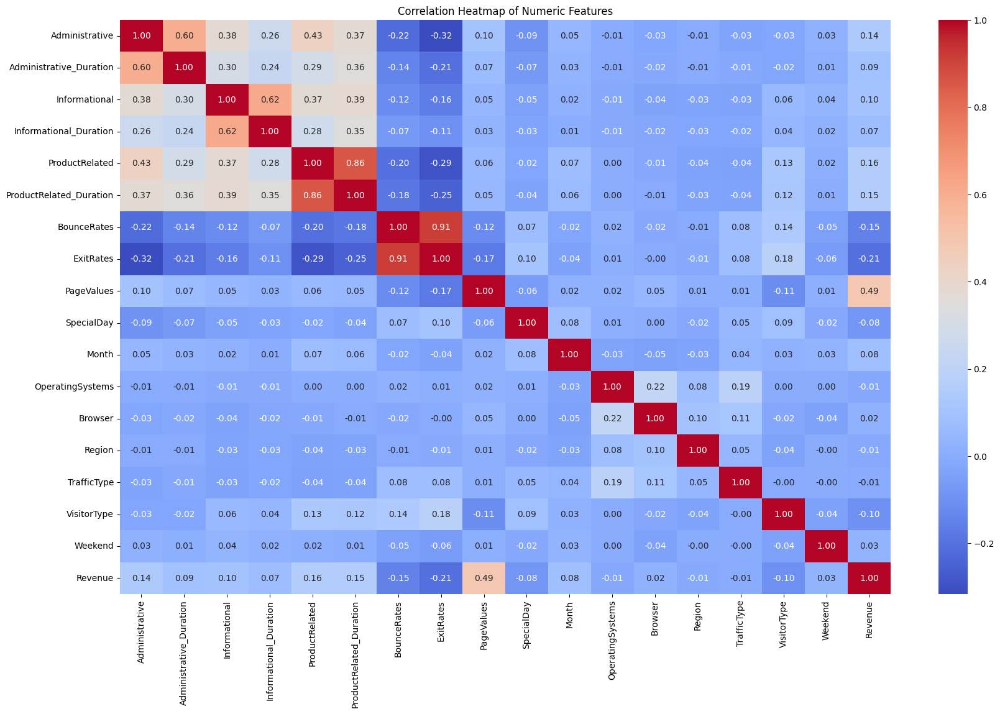

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Select only numeric columns
numeric_df = merged_df.select_dtypes(include=[np.number])

plt.figure(figsize=(20, 12))
sns.heatmap(numeric_df.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap of Numeric Features")
plt.show()


# **EDA Analysis**

**Univariate Analysis**

Below is a **brief summary** of the univariate analysis techniques applied and their **relevance** to understanding the dataset:

1. **Descriptive Statistics**  
   - Calculated basic metrics (mean, median, quartiles, etc.) to quickly gauge the center, spread, and range of each variable.  
   - Highlights unusual values or distributions (e.g., many zeros, extreme maxima).

2. **Histograms**  
   - Visualized the frequency distribution of each variable.  
   - Helps detect concentration around certain values and identify potential outliers or “peaks” in the data.

3. **Violin Plots**  
   - Combined box plots with a density plot to show both the summary statistics and the shape of each variable’s distribution.  
   - Reveals any multi-modal patterns and emphasizes where data points cluster most densely.

4. **Box Plots**  
   - Showed quartiles and potential outliers in a concise format.  
   - Immediately flags extreme values and helps compare the spread across different variables.

Overall, these methods provided a **comprehensive view** of how each variable is distributed, which variables might contain outliers or predominantly zero values, and which might actually be categorical in nature. This foundation is crucial for guiding data cleaning, transformation, and more advanced modeling steps.

##Descriptive Statistics

In [ ]:
merged_df[['Administrative', 'Administrative_Duration', 'Informational', 'Informational_Duration', 'Revenue']].describe()  # Summary statistics for selected columns



,Administrative,Administrative_Duration,Informational,Informational_Duration,Revenue
count,1.233000e+04,1.233000e+04,1.233000e+04,1.233000e+04,1.233000e+04
mean,-2.996612e-17,6.281359e-17,-4.610172e-18,-2.535595e-17,-4.610172e-17
std,1.000041e+00,1.000041e+00,1.000041e+00,1.000041e+00,1.000041e+00
min,-6.969930e-01,-4.571914e-01,-3.964779e-01,-2.449305e-01,-4.278718e-01
25%,-6.969930e-01,-4.571914e-01,-3.964779e-01,-2.449305e-01,-4.278718e-01
50%,-3.959377e-01,-4.147639e-01,-3.964779e-01,-2.449305e-01,-4.278718e-01
75%,5.072280e-01,7.035981e-02,-3.964779e-01,-2.449305e-01,-4.278718e-01
max,7.431499e+00,1.876956e+01,1.849960e+01,1.786868e+01,2.337149e+00


##Histograms

In [ ]:
import plotly.express as px

# Loop over every column in merged_df to create histograms.
for col in merged_df.columns:
    fig = px.histogram(merged_df, x=col, title=f'Histogram of {col}')
    fig.show()  # Displays  plot for each column


##Box Plots

In [ ]:
import plotly.express as px
import pandas as pd


data = merged_df.copy()  # Using all columns in merged_df

# Convert the DataFrame from wide to long format for easy plotting
data_long = data.melt(var_name='Variable', value_name='Value')

# Create interactive box plots with Plotly Express
fig = px.box(
    data_long,
    x="Variable",
    y="Value",
    color="Variable",
    color_discrete_sequence=px.colors.qualitative.Set1,
    title="Interactive Box Plots for All Variables in merged_df"
)

# layout for a dark-themed background and enhanced visual appeal
fig.update_layout(
    title_x=0.5,                      # Center the title
    paper_bgcolor='rgb(0, 0, 0)',       # Background color of the entire figure
    plot_bgcolor='rgb(23, 23, 23)',     # Plot area background color
    font=dict(color='white'),         # Set text color to white for better visibility
    hoverlabel=dict(
        bgcolor="black",              # Background color of hover labels
        font_size=14,                 # Font size of hover labels
        font_color='white'            # Font color of hover labels
    )
)

# Enhance axes titles for better readability
fig.update_xaxes(title_font=dict(size=18, family='Courier', color='white'))
fig.update_yaxes(title_font=dict(size=18, family='Courier', color='white'))

# Display the interactive plot
fig.show()



##Violin Plots

In [ ]:
# Interactive Violin Plots with box overlay for all columns
for col in merged_df.columns:
    fig = px.violin(merged_df, y=col, box=True, points='all', title=f'Violin Plot of {col}')
    fig.show()  # Displays an interactive violin plot for each column

**Summary**


---

### Descriptive Statistics
- **Record Count**: 12,330 observations.
- **Standardization**: Most variables have been scaled (mean ≈ 0, std ≈ 1).
- **Central Values**:  
  - *Administrative*: 25th, 50th, and 75th percentiles are -0.697, -0.396, and 0.507 respectively.
  - *Informational* and *Informational_Duration*: All three percentiles are -0.396 and -0.245 respectively, meaning 75% of values are the same.
  - *Revenue*: The 25th, 50th, and 75th percentiles are all -0.428.
- **Outliers**:  
  - *Administrative* reaches a maximum of 7.43.
  - *Administrative_Duration* goes up to 18.77.
  - *Informational* has a max of 18.50.
  - *Informational_Duration* max is 17.87.
  - *Revenue* reaches 2.34.

---

### Histograms
- **Frequency Peaks**: Many variables show most values clustered around one number.
- **Example**:  
  - *Informational* and *Revenue* have a large number of observations at -0.396 and -0.428 respectively.
- **Outlier Presence**: Histograms clearly show a few records with much higher values than the majority.

---

### Violin Plots
- **Shape & Density**:  
  - Violin plots confirm that most data points are very close together with a few points far out.
  - For example, *Revenue* shows a dense area at -0.428 and a few points reaching 2.34.
- **Categorical Look**:  
  - Some variables, like those with single values at the 25th, 50th, and 75th percentiles, appear almost like categories.

---

### Box Plots
- **Quartile Details**:  
  - Box plots show the median and quartile ranges clearly.
  - In *Revenue*, the box is very narrow (all at -0.428) with a few high outliers (max = 2.34).
- **Outlier Identification**:  
  - The box plots quickly highlight records that are far from the bulk of the data.

---

**Overall Summary**:  
The univariate analysis shows that the dataset of 12,330 records is standardized, with most values centered around 0. Many variables have 75% of the data at one fixed value (like -0.396 for Informational and -0.428 for Revenue). However, there are a few records with very high values (up to 7.43 in Administrative and 18.77 in Administrative_Duration). These findings help us understand that some features behave like categorical variables or are zero-inflated, and a few extreme cases may need further investigation in future analyses.

## **Bivariate Analysis**


Below is a brief summary of the **bivariate analysis** techniques applied and their relevance in understanding how pairs of variables relate within the dataset:

---

### Correlation Matrix

- **Purpose**: Quantify the strength and direction of relationships between numeric variables.  
### Scatter Plots (with Optional Color-Coding by a Categorical Variable)

- **Purpose**: Visualize pairwise relationships between two numeric features.  
- **Approach**:
  1. **Basic Scatter**: Helps spot trends, clusters, or outliers in the 2D space.  
  2. **Color-Coded Scatter**: By coloring points according to a binary or categorical feature (e.g., `Revenue`), we can see how different outcomes or categories cluster within the numeric relationship.

### Box/Violin Plots by a Categorical Variable

- **Purpose**: Compare distributions of numeric variables across two or more categories.  
- **Approach**:
  1. **Box Plots**: Show quartiles and outliers for each category side by side.  
  2. **Violin Plots**: Combine box plot data with a density curve for a richer view of how the data is distributed within each category.

---


## Box/Violin Plots

In [ ]:
import plotly.express as px

# Single feature example using a violin plot with embedded box plot
fig = px.violin(merged_df,
                x='Revenue',         # Categorical/binary variable on the x-axis
                y='ProductRelated',  # Numeric feature on the y-axis
                box=True,            # Display a box plot inside the violin
                points='all',        # Show individual data points
                title='ProductRelated by Revenue (Violin Plot)')
fig.show()

# Alternatively, using a box plot
fig = px.box(merged_df,
             x='Revenue',
             y='ProductRelated',
             title='ProductRelated by Revenue (Box Plot)')
fig.show()


## Scatter Plots

In [ ]:
import plotly.express as px

fig = px.scatter(merged_df,
                 x='ProductRelated',
                 y='BounceRates',
                 color='Revenue',  # Color-coded by revenue category
                 title='Scatter: ProductRelated vs. BounceRates by Revenue')
fig.show()


## Violin Plot

## **Summary**

1. **Correlation Analysis**  
   - **Strong Pairs**:  
     - *BounceRates* ↔ *ExitRates* (≈0.91) – Nearly redundant, indicating they may measure very similar user behaviors.  
     - *ProductRelated* ↔ *ProductRelated_Duration* (≈0.86) – Time spent on product pages aligns closely with the number of product pages viewed.
   - **Moderate Predictors**:  
     - *PageValues* shows a noticeable positive correlation (≈0.49) with `Revenue`, potentially making it a key predictor.  
     - *Administrative* ↔ *Administrative_Duration* also correlate well (≈0.60), suggesting overlap in how these features capture checkout-related page visits.

2. **Violin/Box Plots by `Revenue`**  
   - **Product-Related Features**:  
     - Sessions that eventually yield revenue typically have **higher** counts/durations of product pages. However, some non-revenue sessions also exhibit substantial product-page engagement without purchasing (outliers).  
   - **Bounce/Exit Rates**:  
     - Lower bounce/exit rates are more common in revenue sessions, though a few users with unusually high rates still convert, implying fast but decisive purchases.  
   - **Administrative/Informational**:  
     - Revenue sessions show a slight but consistent increase in administrative interactions—likely related to the checkout process. Informational usage remains low for most, with only a small subset of high informational engagement in revenue groups.

3. **Scatter Plots**  
   - **ProductRelated vs. BounceRates** (Color by Revenue):  
     - Broadly inverse relationship: as *ProductRelated* pages increase, *BounceRates* tend to drop.  
     - The presence of high-product, high-bounce outliers indicates that not all heavy browsing guarantees a sale.

---

## **Key Findings & Takeaways**

1. **Engagement Matters**  
   - Features reflecting user engagement with products (*ProductRelated*, *PageValues*) correlate with purchase behavior. High engagement often coincides with revenue sessions, but not universally.

2. **Redundancies & Multicollinearity**  
   - Certain pairs (e.g., *BounceRates* vs. *ExitRates*) measure similar behaviors, suggesting one could be dropped or combined in modeling to avoid overfitting.

3. **Skew & Outliers**  
   - Many features (counts/durations/rates) are heavily right-skewed, with most users clustering near zero and a small fraction showing intense engagement or extreme rates.  
   - Outliers in non-purchase sessions (high page views but no revenue) imply other unmeasured factors (e.g., user’s final decision, competitor’s prices) may intervene.

4. **Future Modeling**  
   - **Feature Engineering**:  
     - Log-transform or bin heavily skewed features.  
     - Combine correlated metrics (e.g., bounce/exit rates into a single measure).  
   - **Statistical Tests**:  
     - Perform formal tests (e.g., t-test, Mann–Whitney) to confirm distribution differences across revenue vs. non-revenue.  
   - **Multivariate Models**:  
     - No single feature perfectly predicts revenue; a combination of engagement metrics may yield the strongest predictive power.

Overall, these bivariate analyses solidify **user engagement** (especially with product pages) and **low bounce/exit rates** as **key indicators** of higher purchase likelihood. However, overlapping distributions and outliers emphasize that multiple features—and potentially additional contextual data—are needed for more accurate revenue predictions.

Summary
### **Multivariate Analysis**

Below is a Summary of the **multivariate analysis** process, combining various techniques used to explore higher-dimensional relationships among the dataset’s features:

---

1. **Correlation Matrix of Numerical Features**  
   - **Objective**: Quickly identify linear relationships between numeric variables.  
   - **Approach**:  
     1. Selected all numeric columns.  
     2. Computed pairwise correlation (e.g., Pearson’s) to capture the strength and direction of linear associations.  
     3. Visualized using a **heatmap** to highlight correlated clusters and near-zero relationships.  

2. **Principal Component Analysis (PCA)**  
   - **Objective**: Reduce dimensionality while retaining the bulk of the variance.  
   - **Approach**:  
     1. Standardized numeric features to ensure all variables contributed equally.  
     2. Applied PCA, extracting a chosen number of components (often 2 or 3).  
     3. Examined **explained variance ratio** to determine how much information each component captured.  
  
3. **Scatter Matrix / Pairwise Plots**  
   - **Objective**: Visualize pairwise relationships among multiple features simultaneously.  
   - **Approach**:  
     1. Created an **interactive scatter matrix** (e.g., Plotly) to see every pair of variables in a grid.  
     2. Colored points by a target or categorical feature (e.g., `Revenue`) to observe how categories distribute.  
   
4. **Interactive 3D Plots**  
   - **Objective**: Go beyond 2D to see multivariate structure or clustering in three-dimensional space.  
   - **Approach**:  
     1. Selected three important or PCA-derived features.  
     2. Plotted points in **3D scatter** with color or size representing an additional dimension (e.g., `Revenue`).  
   Category Interactions**  
   - **Objective**: Summarize numeric outcomes across multiple **categorical** dimensions.  
   - **Approach**:  
     1. Used **groupby** or **pivot** to calculate metrics (e.g., mean `PageValues`) for combinations of two or more categorical features.  
     2. Visualized results via **heatmaps** or **grouped bar charts** for quick comparison.  
   

6. **Feature Importance (via Simple Models)**  
   - **Objective**: Identify which variables (and by extension, which interactions) might most influence a target outcome.  
   - **Approach**:  
    1. Examined **feature importances** to see which variables heavily drive predictions.  
   

---



Scatter Matrix / Pairwise Plots

In [ ]:
import plotly.express as px

fig = px.scatter_3d(
    merged_df,
    x='Administrative',
    y='Informational',
    z='ProductRelated',
    color='Revenue',  # or any other categorical variable
    title="3D Scatter Plot of Three Features"
)
fig.show()



Pivot_Data

In [ ]:
# Example: Analyzing average 'PageValues' by 'VisitorType' and 'Weekend'
pivot_data = (
    merged_df
    .groupby(['VisitorType', 'Weekend'])['PageValues']
    .mean()
    .reset_index()
    .pivot(index='VisitorType', columns='Weekend', values='PageValues')
)

# Display pivot table
pivot_data


Weekend,-0.550552,1.816360
VisitorType,,
-2.487697,0.295838,0.179635
-1.039955,0.728833,-0.075676
0.407786,-0.058613,-0.009654


Scatter Matrix

In [ ]:
import plotly.express as px

# List of numeric columns you want to analyze
num_cols = ['Administrative', 'Informational', 'ProductRelated', 'BounceRates', 'ExitRates']

#scatter matrix
fig = px.scatter_matrix(
    merged_df,
    dimensions=num_cols,
    color='Revenue',                # Optional: color points by a categorical or numeric column
    title="Scatter Matrix"
)


# fig.update_traces(diagonal_visible=False)

# Adjust layout for better viewing
fig.update_layout(
    width=1000,
    height=800,
    dragmode='select'
)

# Show the interactive figure
fig.show()


PCA

In [ ]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# 1. Select numeric columns (avoid dummy variables or categorical columns)
numeric_cols = merged_df.select_dtypes(include=['float64', 'int64']).columns
X = merged_df[numeric_cols].copy()

# 2. (Optional) Drop target column if present among numeric_cols
#    e.g., if 'Revenue' is your target, remove it from X
if 'Revenue' in X.columns:
    X.drop('Revenue', axis=1, inplace=True)

# 3. Scale data so each feature has zero mean and unit variance
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 4. Perform PCA to reduce to 2 or 3 principal components
pca = PCA(n_components=3)  # choose how many components you want
principal_components = pca.fit_transform(X_scaled)

# 5. Create a DataFrame containing the principal components
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2', 'PC3'])

# 6. Print explained variance ratio to see how much variance is captured
print("Explained Variance Ratio:", pca.explained_variance_ratio_)


Explained Variance Ratio: [0.20093093 0.10573323 0.08258887]


In [ ]:
import plotly.express as px

# Combine the PCA components with your target or any other variable for coloring
# For example, if you want to color by 'Revenue':
pca_df['Revenue'] = merged_df['Revenue'].values  # only if it exists

# Create a 2D scatter plot using the first two principal components
fig_2d = px.scatter(
    pca_df,
    x='PC1',
    y='PC2',
    color='Revenue',             # optional: color points by a categorical/numerical feature
    title='PCA (2D) - PC1 vs PC2'
)

fig_2d.show()


In [ ]:
# Create a 3D scatter plot using the first three principal components
fig_3d = px.scatter_3d(
    pca_df,
    x='PC1',
    y='PC2',
    z='PC3',
    color='Revenue',             # optional: color by 'Revenue' or another feature
    title='PCA (3D) - PC1 vs PC2 vs PC3'
)

fig_3d.show()


Summary  

1. **Scatter Matrix (Feature Interactions with Revenue)**  
   - **Revenue is positively concentrated with:**  
     - **PageValues (0.49)** – higher engagement leads to more revenue.  
     - **ProductRelated (0.16) and ProductRelated_Duration (0.15)** – longer product interaction correlates with higher revenue.  
   - **Revenue is negatively associated with:**  
     - **ExitRates (-0.21)** – users exiting quickly result in lower revenue.  
     - **BounceRates (-0.15)** – high bounce rates reduce revenue potential.  

2. **3D Scatter Plot (ProductRelated vs Other Features)**  
   - Revenue is **higher (yellow points)** where **ProductRelated** visits increase.  
   - Clusters indicate revenue grows with deeper product engagement.  

3. **Correlation Heatmap**  
   - **Strongest positive correlation:** **PageValues (0.49), ProductRelated (0.16)**.  
   - **Strongest negative correlation:** **ExitRates (-0.21), BounceRates (-0.15)**.  
   - Most other features show weak correlation, suggesting non-linearity in revenue drivers.  

4. **PCA Visualizations (PC1 vs PC2 vs PC3 & PC1 vs PC2)**  
   - Revenue clusters in specific PC1 and PC2 ranges, showing structured variance.  
   - Some outliers exist, indicating potential key customer segments.  
   - PC3 does not significantly impact revenue clustering.  

### **Key Takeaways:**  
- **Higher PageValues and ProductRelated interactions drive revenue.**  
- **High ExitRates and BounceRates reduce revenue.**  
- **PCA shows structured variance, confirming feature importance.**

# Regression For Feature Selection

## Splitting the Data

In [ ]:
merged_df.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,-0.696993,-0.457191,-0.396478,-0.244931,-0.691003,-0.624348,3.667189,3.229316,-0.317178,-0.308821,-1.334959,-1.233426,-0.790293,-0.894178,-0.762629,0.407786,-0.550552,-0.427872
1,-0.696993,-0.457191,-0.396478,-0.244931,-0.668518,-0.590903,-0.457683,1.171473,-0.317178,-0.308821,-1.334959,-0.136078,-0.207952,-0.894178,-0.514182,0.407786,-0.550552,-0.427872
2,-0.696993,-0.457191,-0.396478,-0.244931,-0.691003,-0.624348,3.667189,3.229316,-0.317178,-0.308821,-1.334959,2.058618,-0.790293,2.437081,-0.265735,0.407786,-0.550552,-0.427872
3,-0.696993,-0.457191,-0.396478,-0.244931,-0.668518,-0.622954,0.573535,1.994610,-0.317178,-0.308821,-1.334959,0.961270,-0.207952,-0.477771,-0.017289,0.407786,-0.550552,-0.427872
4,-0.696993,-0.457191,-0.396478,-0.244931,-0.488636,-0.296430,-0.045196,0.142551,-0.317178,-0.308821,-1.334959,0.961270,0.374389,-0.894178,-0.017289,0.407786,1.816360,-0.427872


In [ ]:
from sklearn.model_selection import train_test_split


X = merged_df.drop(columns=['Revenue'])
y = merged_df['Revenue']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

print(f"X_train shape: {X_train.shape}, X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}, y_test shape: {y_test.shape}")

X_train shape: (9864, 17), X_test shape: (2466, 17)
y_train shape: (9864,), y_test shape: (2466,)


With the Data split, we can create a model that can be testd with unseen data. This will be very beneficial to us later when assessing the model.

In [ ]:
import statsmodels.api as sm


X_train = sm.add_constant(X_train)
model = sm.OLS(y_train, X_train).fit()

p_values = model.pvalues
print(p_values)

const                      9.840289e-01
Administrative             2.758630e-01
Administrative_Duration    9.977642e-01
Informational              1.563920e-01
Informational_Duration     9.807693e-01
ProductRelated             3.100931e-03
ProductRelated_Duration    1.904499e-02
BounceRates                1.138741e-03
ExitRates                  1.945348e-10
PageValues                 0.000000e+00
SpecialDay                 6.562615e-07
Month                      2.993931e-10
OperatingSystems           2.582717e-02
Browser                    1.234077e-01
Region                     1.963739e-01
TrafficType                4.907548e-01
VisitorType                1.404820e-05
Weekend                    3.888079e-02
dtype: float64


### Creating a statistically significant dataset

In [ ]:
#(0.05 or 0.1 based on preference)
significance_threshold = 0.05

significant_features = p_values[p_values < significance_threshold].index

X_train_selected = X_train[significant_features]

In this section of the code, we have decided to create a new dataset called "x_train_selected" that only takes into account features from the dataset that are statistically significant in regards to the y variable (target variable) "revenue" based on the P-Values of the regression models.
Given that when it comes to statistical significance in regards to P-Values the values have to be lower than 0.05, we have set the threshold to 0.05.


In [ ]:
X_train_selected = sm.add_constant(X_train_selected)
model_refined = sm.OLS(y_train, X_train_selected).fit()
print(model_refined.summary())

                            OLS Regression Results                            
Dep. Variable:                Revenue   R-squared:                       0.286
Model:                            OLS   Adj. R-squared:                  0.285
Method:                 Least Squares   F-statistic:                     394.5
Date:                Tue, 04 Mar 2025   Prob (F-statistic):               0.00
Time:                        10:57:08   Log-Likelihood:                -12334.
No. Observations:                9864   AIC:                         2.469e+04
Df Residuals:                    9853   BIC:                         2.477e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                   -2

Based on the results that we got from the new datast, we have com to the understanding that OperatingSystems and Const are not statistically significant, as their P-Values are higher than 0.05. This indicates that moving froward the model of choice should only take into account the the other features.

# Model Building and evaluation

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
!pip install xgboost lightgbm
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

# Define your features (X) and target (y):
X = merged_df.drop(columns=['Revenue'])
y = merged_df['Revenue']

# Convert y to binary (0 or 1) if necessary
# Assuming you want to classify as 1 if Revenue > 0, otherwise 0
y_binary = (y > 0).astype(int)

# Remove rows with NaN in y_binary if present
X = X[~np.isnan(y_binary)]
y_binary = y_binary[~np.isnan(y_binary)]

# Define your models:
models = {
    "Logistic Regression": LogisticRegression(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "SVM": SVC(),
    "Decision Tree": DecisionTreeClassifier(),
    "XGBoost": XGBClassifier(),
    "LightGBM": LGBMClassifier()
}

# Evaluate each model using cross-validation with 'recall' scoring:
for name, model in models.items():
    scores = cross_val_score(model, X, y_binary, cv=5, scoring='recall')  # Change to 'recall'
    print(f"{name}: Mean Recall = {np.mean(scores):.4f}, Std Dev = {np.std(scores):.4f}")

Logistic Regression: Mean Recall = 0.3716, Std Dev = 0.0346
Random Forest: Mean Recall = 0.5598, Std Dev = 0.0405
Gradient Boosting: Mean Recall = 0.5786, Std Dev = 0.0387
SVM: Mean Recall = 0.4534, Std Dev = 0.0821
Decision Tree: Mean Recall = 0.5294, Std Dev = 0.0305
XGBoost: Mean Recall = 0.5682, Std Dev = 0.0360
[LightGBM] [Info] Number of positive: 1527, number of negative: 8337
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002216 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1897
[LightGBM] [Info] Number of data points in the train set: 9864, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.154805 -> initscore=-1.697398
[LightGBM] [Info] Start training from score -1.697398
[LightGBM] [Info] Number of positive: 1527, number of negative: 8337
[LightGBM] [Info] Auto-choosing row-wise multi-threading, 

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
!pip install xgboost lightgbm
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier


# Define your features (X) and target (y):
X = merged_df.drop(columns=['Revenue'])
y = merged_df['Revenue']

# Convert y to binary (0 or 1) if necessary
# Assuming you want to classify as 1 if Revenue > 0, otherwise 0
y_binary = (y > 0).astype(int)

# Remove rows with NaN in y_binary if present
X = X[~np.isnan(y_binary)]
y_binary = y_binary[~np.isnan(y_binary)]

# Define your models:
models = {
    "Logistic Regression": LogisticRegression(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "SVM": SVC(),
    "Decision Tree": DecisionTreeClassifier(),
    "XGBoost": XGBClassifier(),
    "LightGBM": LGBMClassifier()
}

# Evaluate each model using cross-validation:
for name, model in models.items():
    scores = cross_val_score(model, X, y_binary, cv=5, scoring='accuracy') # Using y_binary for these models
    print(f"{name}: Mean Accuracy = {np.mean(scores):.4f}, Std Dev = {np.std(scores):.4f}")

Logistic Regression: Mean Accuracy = 0.8829, Std Dev = 0.0115
Random Forest: Mean Accuracy = 0.8964, Std Dev = 0.0143
Gradient Boosting: Mean Accuracy = 0.8950, Std Dev = 0.0142
SVM: Mean Accuracy = 0.8909, Std Dev = 0.0168
Decision Tree: Mean Accuracy = 0.8401, Std Dev = 0.0465
XGBoost: Mean Accuracy = 0.8879, Std Dev = 0.0214
[LightGBM] [Info] Number of positive: 1527, number of negative: 8337
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1897
[LightGBM] [Info] Number of data points in the train set: 9864, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.154805 -> initscore=-1.697398
[LightGBM] [Info] Start training from score -1.697398
[LightGBM] [Info] Number of positive: 1527, number of negative: 8337
[LightGBM] [Info] Auto-choosing row-wise multi

For this dataset Random Forest and Gradient Boosting emerged as top performers with high accuracy and consistency, followed closely by SVM, LightGBM and XGBoost. Logistic Regression provides a decent baseline, while Decision Tree showed lower accuracy and higher variability. Next steps involve hyperparameter tuning for the best models, using the feature importance from the linear rgression, considering other ensemble methods, and addressing potential overfitting with regularization or feature selection.

# Baseline Model

In [ ]:
# based on the results of the model_refined.summary build a baseline logistic regression model
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Remove the constant if present
if 'const' in X_train_selected.columns:
    X_train_selected = X_train_selected.drop('const', axis=1)

# Convert y_train to discrete values if it's continuous
# Assuming y_train is a Pandas Series:
y_train_discrete = y_train.astype(int)  # Convert to integers representing classes



# Initialize and train the logistic regression model
logreg_model = LogisticRegression(random_state=42)  # Set random_state for reproducibility
logreg_model.fit(X_train_selected, y_train_discrete) # Use the discrete target variable

# Prepare the test data
X_test_selected = X_test[X_train_selected.columns] # Ensure same columns as training

# Convert y_test to discrete values if necessary (using the same method as y_train)
y_test_discrete = y_test.astype(int)  # Or apply the threshold as done for y_train

# Make predictions on the test data
y_pred = logreg_model.predict(X_test_selected)

# Evaluate the model
accuracy = accuracy_score(y_test_discrete, y_pred) # Use the discrete target for evaluation
print(f"Accuracy: {accuracy}")
print(classification_report(y_test_discrete, y_pred))

Accuracy: 0.883617193836172
              precision    recall  f1-score   support

           0       0.89      0.98      0.93      2084
           2       0.77      0.36      0.49       382

    accuracy                           0.88      2466
   macro avg       0.83      0.67      0.71      2466
weighted avg       0.87      0.88      0.87      2466



The baseline Logistic Regression model achieved 88% accuracy, demonstrating strong performance in predicting no-revenue cases (class 0) with 98% recall. However, it struggles with revenue prediction (class 2), achieving only 36% recall. This indicates a high number of missed revenue opportunities. While precision for revenue is decent (77%), the overall F1-score for class 2 remains low at 0.49.


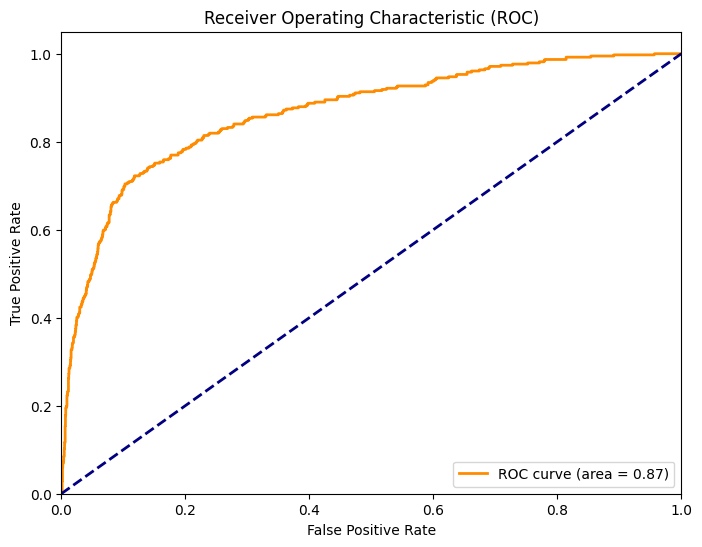

In [ ]:
from sklearn.metrics import roc_curve, auc, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure X_test_sig has the same columns as used during training (X_train_selected)
X_test_sig = X_test[X_train_selected.columns]

# Create y_test_sig by selecting the corresponding target values from y_test
y_test_sig = y_test[X_test.index.isin(X_test_sig.index)]

# Convert y_test_sig to binary (0 or 1) if necessary
# Assuming you want to classify as 1 if Revenue > 0, otherwise 0
y_test_sig_discrete = (y_test_sig > 0).astype(int)  # Explicitly convert to binary {0, 1}


# Predict probabilities for the positive class of the logistic regression model
y_prob = logreg_model.predict_proba(X_test_sig)[:, 1]

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test_sig_discrete, y_prob)  # Assuming y_test_sig is the correct target for this evaluation
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()


# Predict classes
y_pred = logreg_model.predict(X_test_sig)

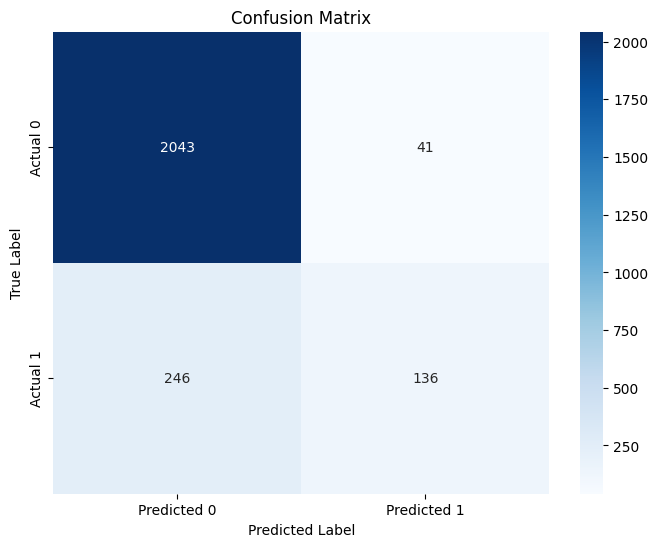

In [ ]:
# do a confusion matrix for the model
# Compute the confusion matrix
cm = confusion_matrix(y_test_discrete, y_pred)

# Plot the confusion matrix using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


The model achieves AUC 0.87, showing moderate performance. The confusion matrix reveals 2043 true negatives and 136 true positives, with 246 false negatives (missed revenue) and 41 false positives. The model excels at identifying no-revenue cases but struggles with recall (36%) for revenue, missing most revenue opportunities. While precision is higher, the low recall suggests the model needs improvement to better capture revenue cases, potentially through threshold tuning or resampling techniques.

# Feature selection using p-values

In [ ]:
# The next features are selected from the p-values from the regression
# ProductRelated (p-value: 3.100931e-03)
# ProductRelated_Duration (p-value: 1.904499e-02)
# BounceRates (p-value: 1.138741e-03)
# ExitRates (p-value: 1.945348e-10)
# PageValues (p-value: 0.000000e+00)
# SpecialDay (p-value: 6.562615e-07)
# Month (p-value: 2.993931e-10)
# VisitorType (p-value: 1.404820e-05)

# Assuming 'model_refined' and 'significant_features' are defined from the previous code
significant_features = ['ProductRelated', 'ProductRelated_Duration', 'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay', 'Month', 'VisitorType']
significant_features


['ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues',
 'SpecialDay',
 'Month',
 'VisitorType']

# Hyperparameter tuning

In [ ]:
# do a hyperparameter tuning for the random forrest
from sklearn.model_selection import RandomizedSearchCV
# Assuming 'significant_features', 'X_train', and 'y_train' are defined from previous cells
X_train_sig = X_train[significant_features]  # Selecting significant features for training data
y_train_sig = y_train[X_train.index.isin(X_train_sig.index)] # Selecting corresponding target values

# Convert y_train_sig to binary if it's not already
y_train_sig_binary = (y_train_sig > 0).astype(int)


# Create the parameter grid based on the documentation
param_grid = {
    'n_estimators': [50, 100, 200],  # Number of trees in the forest
    'max_depth': [None, 10, 20, 30],  # Maximum depth of the tree
    'min_samples_split': [2, 5, 10],  # Minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 4],  # Minimum number of samples required to be at a leaf node
    'max_features': ['sqrt', 'log2'],  # Number of features to consider when looking for the best split
}

# Initialize the RandomForestClassifier
rf_model = RandomForestClassifier(random_state=42)

# Create RandomizedSearchCV object
random_search = RandomizedSearchCV(estimator=rf_model,
                                   param_distributions=param_grid,
                                   n_iter=10, # Number of parameter settings sampled
                                   cv=5, # Number of cross-validation folds
                                   scoring='accuracy', # Use appropriate scoring metric
                                   n_jobs=-1,
                                   verbose=2,
                                   random_state=42)

# Fit the random search to the data
random_search.fit(X_train_sig, y_train_sig_binary) # Use the binary target variable


# Print the best parameters and best score
print("Best parameters found: ", random_search.best_params_)
print("Best accuracy found: ", random_search.best_score_)

# Evaluate on the test set
best_rf_model = random_search.best_estimator_

# Ensure X_test_sig has the same columns as training data
X_test_sig = X_test[significant_features]
y_test_sig_binary = (y_test[X_test.index.isin(X_test_sig.index)] > 0).astype(int)

y_pred_best_rf = best_rf_model.predict(X_test_sig)
accuracy_best_rf = accuracy_score(y_test_sig_binary, y_pred_best_rf)
print(f"Best Random Forest Accuracy on Test Set: {accuracy_best_rf}")


Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters found:  {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': 'sqrt', 'max_depth': 30}
Best accuracy found:  0.9033856145181041
Best Random Forest Accuracy on Test Set: 0.9022708840227088


After tuning Random Forest using RandomizedSearchCV with 10 iterations and 5-fold cross-validation, the best hyperparameters were identified, resulting in a mean cross-validation accuracy of 90.3%. Applying this tuned model to the test set yielded an accuracy of 90.2%. Overall, the tuned Random Forest shows strong predictive performance for the target variable.

In [ ]:
# do hyperparameter tuning for XGBOOST

# Assuming X_train_sig, y_train_sig, X_test_sig, y_test_sig are defined
# and you have an XGBoost model named 'xgb_model'

# Define the parameter grid for XGBoost
param_grid_xgb = {
    'n_estimators': [50, 100, 200, 500],
    'max_depth': [3, 5, 7, 9],
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
    'gamma': [0, 0.1, 0.2],
    'min_child_weight': [1, 3, 5]
}

# Initialize the XGBoost classifier
xgb_model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')


# Create RandomizedSearchCV object
random_search_xgb = RandomizedSearchCV(estimator=xgb_model,
                                      param_distributions=param_grid_xgb,
                                      n_iter=50,  # Number of parameter settings sampled
                                      cv=5, # Number of cross-validation folds
                                      scoring='accuracy',
                                      n_jobs=-1,
                                      verbose=2,
                                      random_state=42)

# Convert y_train_sig to binary (0 or 1) if necessary
# Assuming you want to classify as 1 if Revenue > 0, otherwise 0
y_train_sig_binary = (y_train_sig > 0).astype(int)

# Fit the random search to the data using the binary target variable
random_search_xgb.fit(X_train_sig, y_train_sig_binary)

# Print the best parameters and best score
print("Best parameters found (XGBoost): ", random_search_xgb.best_params_)
print("Best accuracy found (XGBoost): ", random_search_xgb.best_score_)

# Evaluate the best model on the test set
best_xgb_model = random_search_xgb.best_estimator_

# Convert y_test_sig to binary (0 or 1) using the same logic
y_test_sig_binary = (y_test_sig > 0).astype(int)

y_pred_best_xgb = best_xgb_model.predict(X_test_sig)
accuracy_best_xgb = accuracy_score(y_test_sig_binary, y_pred_best_xgb)
print(f"Best XGBoost Accuracy on Test Set: {accuracy_best_xgb}")

Fitting 5 folds for each of 50 candidates, totalling 250 fits
Best parameters found (XGBoost):  {'subsample': 0.9, 'n_estimators': 50, 'min_child_weight': 3, 'max_depth': 5, 'learning_rate': 0.1, 'gamma': 0.1, 'colsample_bytree': 0.8}
Best accuracy found (XGBoost):  0.9031830317809699
Best XGBoost Accuracy on Test Set: 0.9034874290348743


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning:

[11:01:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




After tuning XGBoost using RandomizedSearchCV with 50 iterations and 5-fold cross-validation, the best hyperparameters were identified. Using these parameters resulted in a mean cross-validation accuracy of 90.3% and a test set accuracy of 90.3%. Overall, the tuned XGBoost model shows promising results for predicting the target variable.

# Random forrest model

In [ ]:
# evaluate the random forrest model
# Predict on the test set using the best model
y_pred = best_rf_model.predict(X_test_sig)

# Assuming y_test_sig needs to be binary (0 or 1) for classification metrics
y_test_sig_binary = (y_test_sig > 0).astype(int)  # Convert to 1 if Revenue > 0, else 0

# Evaluate the model using the binary target variable
print(classification_report(y_test_sig_binary, y_pred))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94      2084
           1       0.74      0.57      0.65       382

    accuracy                           0.90      2466
   macro avg       0.83      0.77      0.79      2466
weighted avg       0.90      0.90      0.90      2466



The Random Forrest model achieves 90% accuracy, excelling in predicting no-revenue cases with **96% recall** and an F1-score of 0.94. However, the model struggles with 57% recall for revenue cases, meaning it misses many revenue opportunities. Despite a 74% precision for revenue, the F1-score of 0.65 shows room for improvement. The model is reliable but could benefit from optimizing recall to better identify revenue cases without compromising precision.

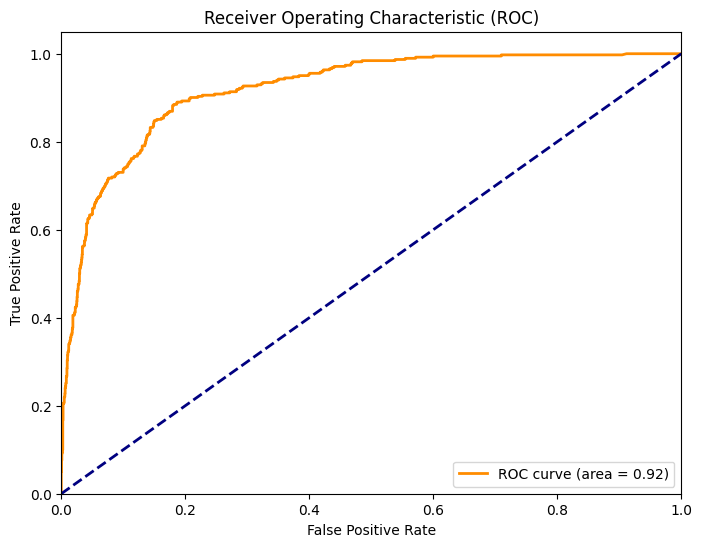

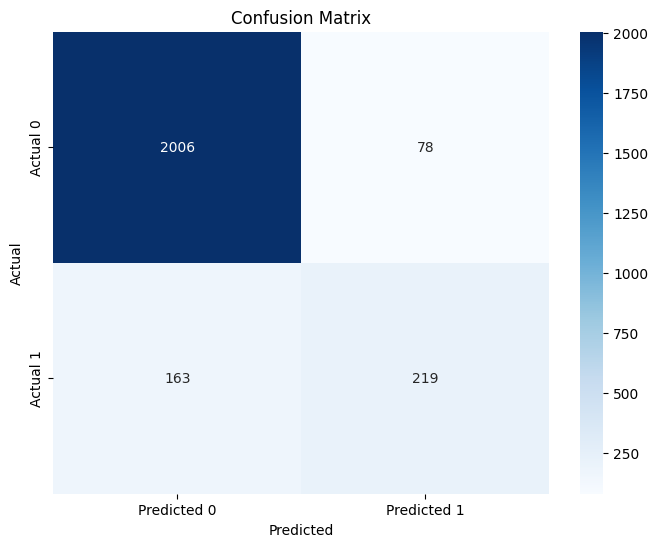

In [ ]:
# Predict probabilities for the positive class
y_prob = best_rf_model.predict_proba(X_test_sig)[:, 1]

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test_sig_binary, y_prob)
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()


# Predict classes
y_pred = best_rf_model.predict(X_test_sig)

# Compute and plot the confusion matrix
cm = confusion_matrix(y_test_sig_binary, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

The Random forrest model achieves AUC 0.92, indicating strong performance. The confusion matrix shows 2006 true negatives and 219 true positives, with 163 false negatives (missed revenue) and 78 false positives (incorrect revenue predictions). The model excels at identifying no-revenue cases but struggles with recall (57%) for revenue, missing a significant portion. Improving recall could enhance revenue detection, balancing precision and sensitivity for better revenue opportunity identification.

# XGBOOST model

In [ ]:
# evaluate the model
# Assuming best_xgb_model is the tuned XGBoost model from the previous code
y_pred_xgb = best_xgb_model.predict(X_test_sig)

# Evaluate the model
accuracy_xgb = accuracy_score(y_test_sig_binary, y_pred_xgb)
print(f"XGBoost Accuracy: {accuracy_xgb}")
print(classification_report(y_test_sig_binary, y_pred_xgb))

XGBoost Accuracy: 0.9034874290348743
              precision    recall  f1-score   support

           0       0.93      0.96      0.94      2084
           1       0.74      0.59      0.65       382

    accuracy                           0.90      2466
   macro avg       0.83      0.77      0.80      2466
weighted avg       0.90      0.90      0.90      2466





The XGBoost model achieves 90.3% accuracy, excelling in predicting no-revenue cases (F1-score: 0.94). However, it struggles with revenue cases, with 59% recall, meaning it misses many actual revenue instances. Precision for revenue is 74%, leading to some false positives. Improving recall—through threshold tuning or resampling—could enhance revenue detection. Overall, the model is strong but could better balance identifying revenue opportunities without sacrificing precision.

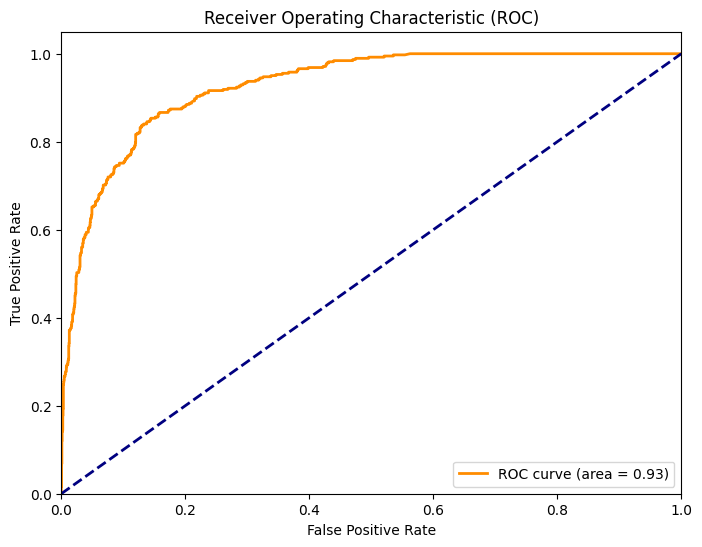

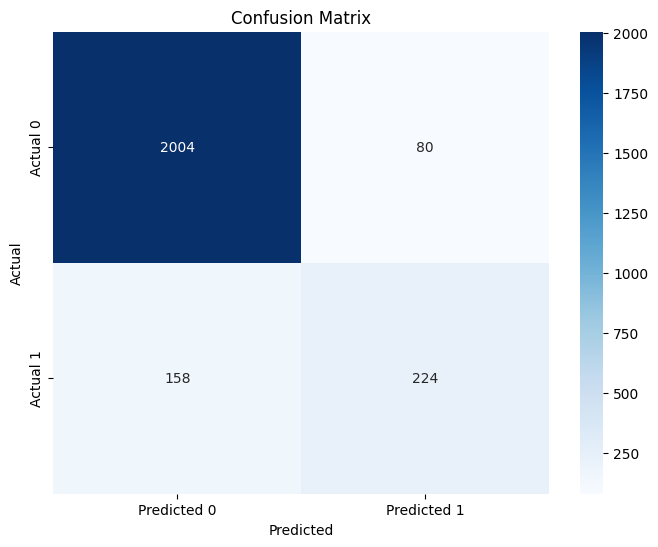

In [ ]:
# Predict probabilities for the positive class
y_prob = best_xgb_model.predict_proba(X_test_sig)[:, 1]

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test_sig_binary, y_prob)
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()


# Predict classes
y_pred = best_xgb_model.predict(X_test_sig)

# Compute and plot the confusion matrix
cm = confusion_matrix(y_test_sig_binary, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

The XGBoost model predicts revenue presence or absence with an AUC of 0.93, showing strong performance. The confusion matrix indicates 2004 true negatives (no revenue correctly predicted) and 224 true positives (revenue correctly predicted), with 158 false negatives (missed revenue) and 80 false positives (incorrectly predicted revenue). The model excels at identifying no-revenue cases but could improve recall to better capture revenue opportunities.